In [111]:
from __future__ import print_function, division

import pandas
import numpy
import scipy.stats
import itertools
import bokeh
from bokeh.plotting import figure, output_file, show, ColumnDataSource
from bokeh import charts
from bokeh.io import output_notebook
from bokeh.models import HoverTool, CategoricalTickFormatter

from matplotlib import pyplot
from mpl_toolkits.axes_grid1 import make_axes_locatable
from matplotlib_venn import venn2

In [2]:
from curation_common import build_geneid_to_gene_from_gtf

In [3]:
%matplotlib inline


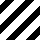
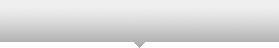
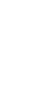
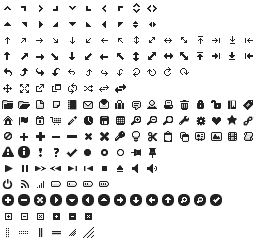
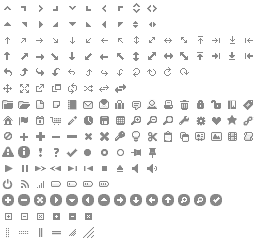
...
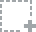
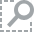
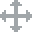
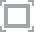
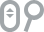

In [4]:
output_notebook()

In [5]:
store = pandas.HDFStore('comparison.h5', 'r')

bulk_cell_line_fpkms = store.get('/bulk_cell_line/fpkms')
bulk_cell_line_scores = store.get('/bulk_cell_line/fpkm_scores')
bulk_cell_line_labels = store.get('/bulk_cell_line/labels')

store.close()

In [6]:
def gene_map_to_series(geneid_map, index):
    genes_series = pandas.DataFrame(
        [ geneid_map.get(gene_id, gene_id) for gene_id in index], 
        index=index, columns=['gene_name'])
    return genes_series

In [7]:
h19_gene_map = build_geneid_to_gene_from_gtf('gencode.v19.annotation.gtf.gz')
h19_gene_series = gene_map_to_series(h19_gene_map, bulk_cell_line_fpkms.index)

In [99]:
bulk_cell_line_labels

ENCLB035ZZZ    ging Total GM12878 r1
ENCLB036ZZZ    ging Total GM12878 r2
ENCLB037ZZZ    ging PolyA GM12878 r1
ENCLB038ZZZ    ging PolyA GM12878 r2
ENCLB039ZZZ    grav Total GM12878 r1
ENCLB040ZZZ    grav Total GM12878 r2
ENCLB041ZZZ    grav PolyA GM12878 r1
ENCLB042ZZZ    grav PolyA GM12878 r2
ENCLB043ZZZ    wold Total GM12878 r1
ENCLB044ZZZ    wold Total GM12878 r2
ENCLB045ZZZ    wold PolyA GM12878 r1
ENCLB046ZZZ    wold PolyA GM12878 r2
ENCLB055ZZZ       ging PolyA K562 r1
ENCLB056ZZZ       ging PolyA K562 r2
ENCLB057ZZZ       grav Total K562 r1
ENCLB058ZZZ       grav Total K562 r2
ENCLB059ZZZ       grav PolyA K562 r1
ENCLB060ZZZ       grav PolyA K562 r2
ENCLB061ZZZ       wold Total K562 r1
ENCLB062ZZZ       wold Total K562 r2
ENCLB063ZZZ       wold PolyA K562 r1
ENCLB064ZZZ       wold PolyA K562 r2
dtype: object

In [106]:
subset_patterns = [
    'Total GM12878',
    'PolyA GM12878',
    'Total K562',
    'PolyA K562'
]
subsets = {}
for pattern in subset_patterns:
    subsets[pattern] = [ row[0] for row in bulk_cell_line_labels.items() if pattern in row[1]]
subsets

{'PolyA GM12878': ['ENCLB037ZZZ',
  'ENCLB038ZZZ',
  'ENCLB041ZZZ',
  'ENCLB042ZZZ',
  'ENCLB045ZZZ',
  'ENCLB046ZZZ'],
 'PolyA K562': ['ENCLB055ZZZ',
  'ENCLB056ZZZ',
  'ENCLB059ZZZ',
  'ENCLB060ZZZ',
  'ENCLB063ZZZ',
  'ENCLB064ZZZ'],
 'Total GM12878': ['ENCLB035ZZZ',
  'ENCLB036ZZZ',
  'ENCLB039ZZZ',
  'ENCLB040ZZZ',
  'ENCLB043ZZZ',
  'ENCLB044ZZZ'],
 'Total K562': ['ENCLB057ZZZ', 'ENCLB058ZZZ', 'ENCLB061ZZZ', 'ENCLB062ZZZ']}

In [9]:
bulk_cell_line_fpkms.describe().T

,count,mean,std,min,25%,50%,75%,max
ENCLB043ZZZ,58540,22.116427,645.506915,0,0,0,0.23,103573.43
ENCLB044ZZZ,58540,22.157354,652.358533,0,0,0,0.24,102413.55
ENCLB045ZZZ,58540,19.025972,481.847674,0,0,0,0.20,67835.09
ENCLB046ZZZ,58540,22.315748,830.080150,0,0,0,0.22,156904.93
ENCLB061ZZZ,58540,20.173679,499.099869,0,0,0,0.23,79611.67
ENCLB062ZZZ,58540,21.408918,553.888155,0,0,0,0.23,90866.44
ENCLB063ZZZ,58540,17.791204,410.004664,0,0,0,0.21,59553.99
ENCLB064ZZZ,58540,18.594962,418.812157,0,0,0,0.20,57540.82
ENCLB039ZZZ,58540,45.772817,3905.920465,0,0,0,0.41,652564.61
ENCLB040ZZZ,58540,44.607106,3764.389586,0,0,0,0.41,628748.30


In [11]:
f = charts.Histogram(bulk_cell_line_fpkms['ENCLB043ZZZ'][(bulk_cell_line_fpkms['ENCLB043ZZZ'] > 0) & (bulk_cell_line_fpkms['ENCLB043ZZZ'] < 100)], 
                     bins=100,
                     density=False)

In [12]:
show(f)

In [13]:
bulk_cell_line_fpkms['ENCLB035ZZZ'].describe()

count      58540.000000
mean          50.766314
std         5200.340721
min            0.000000
25%            0.000000
50%            0.000000
75%            0.330000
max      1023386.310000
Name: ENCLB035ZZZ, dtype: float64

In [14]:
f = charts.Histogram(bulk_cell_line_fpkms['ENCLB035ZZZ'][(bulk_cell_line_fpkms['ENCLB035ZZZ'] > 0) & (bulk_cell_line_fpkms['ENCLB035ZZZ'] < 100)], 
                     bins=100,
                     density=False)
show(f)

In [23]:
Threshold = 0
ging_calls = (bulk_cell_line_fpkms['ENCLB035ZZZ'] > Threshold) & (bulk_cell_line_fpkms['ENCLB036ZZZ'] > Threshold)
wold_calls = (bulk_cell_line_fpkms['ENCLB045ZZZ'] > Threshold) & (bulk_cell_line_fpkms['ENCLB046ZZZ'] > Threshold)


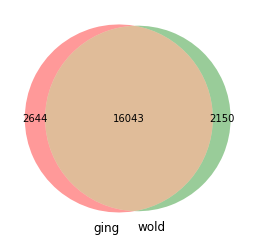

In [24]:
venn2([set(ging_calls[ging_calls].index), set(wold_calls[wold_calls].index)], ['ging', 'wold'])

In [121]:
def scatter(fpkms, rep1, rep2, labels):
    expression = numpy.asarray([ not x.startswith('gSpike') for x in bulk_cell_line_fpkms.index ])
    spikes = (expression == False)
    
    hover = HoverTool(
        tooltips = [
            ('index', '$index'),
            ('(x,y)', '($x, $y)'),
            ('gene_id', '@gene_id'),
        ]
    )
    source=ColumnDataSource({
            'x': fpkms[rep1][spikes],
            'y': fpkms[rep2][spikes],
            'gene_id': fpkms.index[spikes],
    })
    
    f = figure(
        title=labels[rep1] + '-' + labels[rep2],
        tools=['pan','wheel_zoom','box_zoom','reset',hover,'save'],
    )

    f.circle(numpy.log2(bulk_cell_line_fpkms[rep1][expression]), 
             numpy.log2(bulk_cell_line_fpkms[rep2][expression]))
    f.circle(numpy.log2(bulk_cell_line_fpkms[rep1][spikes]), 
             numpy.log2(bulk_cell_line_fpkms[rep2][spikes]),
             color=bokeh.palettes.GnBu3[1],
             source=source)
    
    f.yaxis.axis_label = labels.get(rep2, rep2)
    f.xaxis.axis_label = labels.get(rep1, rep1)    
    return f

def scatter_lab_rep1(subsets, subset_name):
    for lab1, lab2 in itertools.combinations(subsets[subset_name][::2], 2):
        f = scatter(bulk_cell_line_fpkms, lab1, lab2, bulk_cell_line_labels)
        show(f)
        
def scatter_replicates(subsets, subset_name):
    for rep1, rep2 in zip(subsets[subset_name][::2], subsets[subset_name][1::2]):
        f = scatter(bulk_cell_line_fpkms, rep1, rep2, bulk_cell_line_labels)
        show(f)

# PolyA GM12878

## PolyA GM12878 rep1 vs rep2

In [123]:
scatter_replicates(subsets, 'PolyA GM12878')

## PolyA GM12878 lab rep1

In [124]:
scatter_lab_rep1(subsets, 'PolyA GM12878')

# Total GM12878

## Total GM12878 rep1 vs rep2

In [125]:
scatter_replicates(subsets, 'Total GM12878')

## Total GM12878 lab rep1

In [126]:
scatter_lab_rep1(subsets, 'Total GM12878')

# PolyA K562

## PolyA K562 rep1 vs rep2

In [127]:
scatter_replicates(subsets, 'PolyA K562')

## PolyA K562 lab rep1

In [128]:
scatter_lab_rep1(subsets, 'PolyA K562')

# Total K562

## Total K562 rep1 vs rep2

In [129]:
scatter_replicates(subsets, 'Total K562')

## Total K562 lab rep1

In [131]:
scatter_lab_rep1(subsets, 'Total K562')